# Image reconstruction using Machine Learning

This notebook has 2 methods of image reconstruction:
- Using Matrix Factorization
- Using Random Fourier Features

### Importing necessary libraries

In [1]:
import torch
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

import numpy as np
import pandas as pd
import torch.nn as nn
import torch.nn.functional as F

# Remove all the warnings
import warnings

warnings.filterwarnings("ignore")

# Set env CUDA_LAUNCH_BLOCKING=1
import os

os.environ["CUDA_LAUNCH_BLOCKING"] = "1"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Retina display
%config InlineBackend.figure_format = 'retina'

try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.9 MB/s eta 0:00:00


### Importing the image

In [2]:
if os.path.exists("dog.jpg"):
    print("dog.jpg exists")
else:
    !wget https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg -O dog.jpg

--2024-03-05 18:16:47--  https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg
Resolving segment-anything.com (segment-anything.com)... 18.155.68.106, 18.155.68.39, 18.155.68.43, ...
Connecting to segment-anything.com (segment-anything.com)|18.155.68.106|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 221810 (217K) [image/jpeg]
Saving to: ‘dog.jpg’

dog.jpg             100%[===================>] 216.61K  --.-KB/s    in 0.005s  

2024-03-05 18:16:48 (46.6 MB/s) - ‘dog.jpg’ saved [221810/221810]



In [3]:
# Read in a image from torchvision
img = torchvision.io.read_image("dog.jpg")
print(img.shape)

torch.Size([3, 1365, 2048])


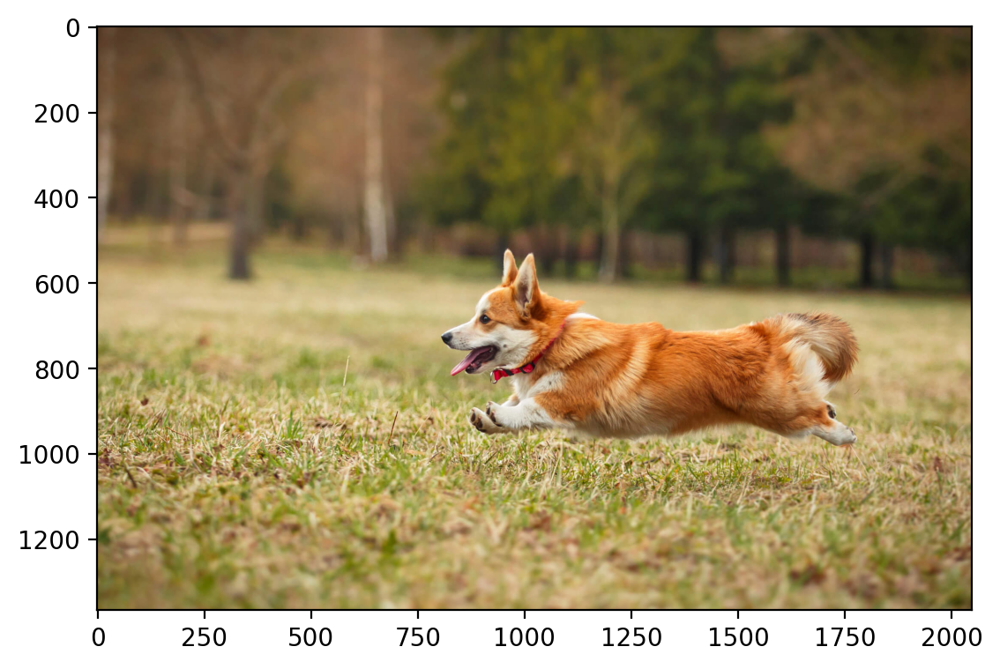

In [4]:
plt.imshow(rearrange(img, "c h w -> h w c").numpy())

In [5]:
from sklearn import preprocessing

scaler_img = preprocessing.MinMaxScaler().fit(img.reshape(-1, 1))
scaler_img

MinMaxScaler()

In [6]:
img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)
img_scaled.shape

img_scaled = torch.tensor(img_scaled)

In [7]:
img_scaled = img_scaled.to(device)
img_scaled

tensor([[[0.3098, 0.3137, 0.3137,  ..., 0.2941, 0.2941, 0.2980],
         [0.3098, 0.3137, 0.3137,  ..., 0.2941, 0.2941, 0.2980],
         [0.3098, 0.3137, 0.3137,  ..., 0.2941, 0.2941, 0.2980],
         ...,
         [0.4745, 0.4745, 0.4784,  ..., 0.3804, 0.3765, 0.3765],
         [0.4745, 0.4745, 0.4784,  ..., 0.3804, 0.3804, 0.3765],
         [0.4745, 0.4745, 0.4784,  ..., 0.3843, 0.3804, 0.3804]],

        [[0.2039, 0.2078, 0.2078,  ..., 0.2157, 0.2157, 0.2118],
         [0.2039, 0.2078, 0.2078,  ..., 0.2157, 0.2157, 0.2118],
         [0.2039, 0.2078, 0.2078,  ..., 0.2157, 0.2157, 0.2118],
         ...,
         [0.4039, 0.4039, 0.4078,  ..., 0.3216, 0.3176, 0.3176],
         [0.4039, 0.4039, 0.4078,  ..., 0.3216, 0.3216, 0.3176],
         [0.4039, 0.4039, 0.4078,  ..., 0.3255, 0.3216, 0.3216]],

        [[0.1373, 0.1412, 0.1412,  ..., 0.1176, 0.1176, 0.1176],
         [0.1373, 0.1412, 0.1412,  ..., 0.1176, 0.1176, 0.1176],
         [0.1373, 0.1412, 0.1412,  ..., 0.1176, 0.1176, 0.

### Crop the image

In [8]:
crop = torchvision.transforms.functional.crop(img_scaled.cpu(), 600, 800, 300, 300)
crop.shape

torch.Size([3, 300, 300])

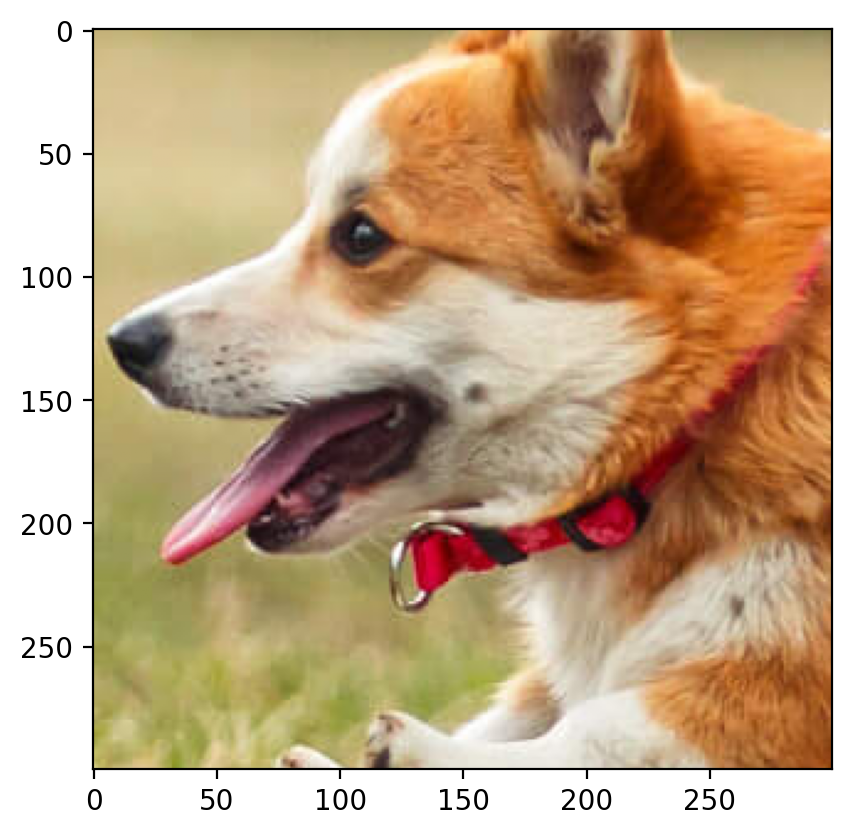

In [9]:
plt.imshow(rearrange(crop, "c h w -> h w c").cpu().numpy())

In [10]:
crop = crop.to(device)

### Create a masked image for reconstruction

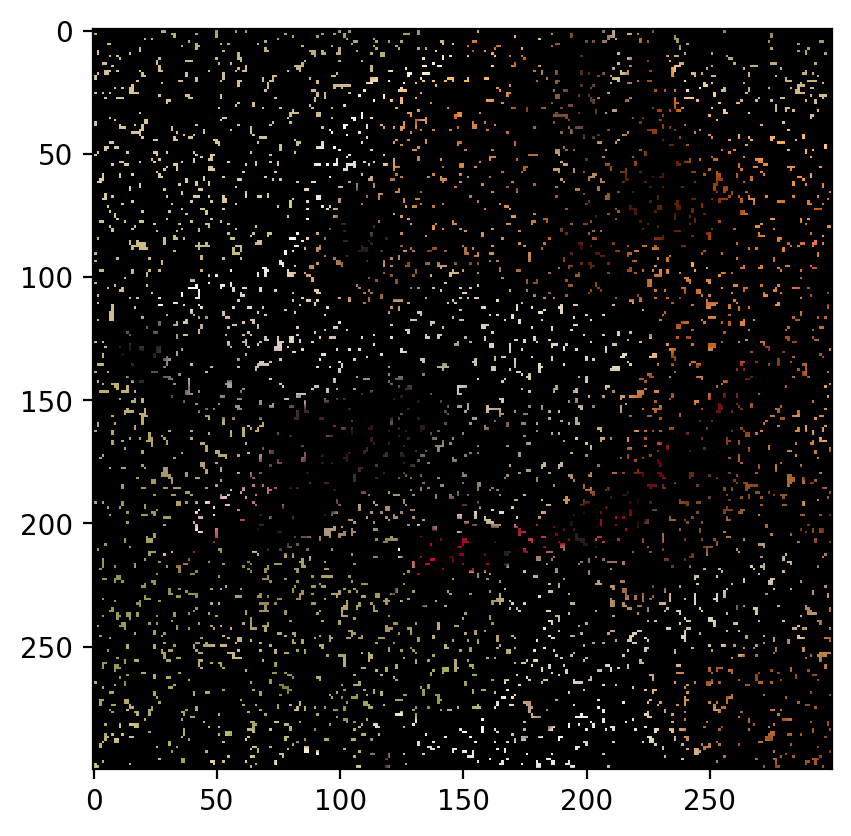

In [11]:
# Mask the image with NaN values


def mask_image_rgb(
    img, prop
):  # edited to remove the same points from all 3 channels, r,g and b.
    img_copy = img.clone()
    mask = torch.rand(img[0].shape) < prop
    img_copy[0][mask] = float("nan")
    img_copy[1][mask] = float("nan")
    img_copy[2][mask] = float("nan")
    return img_copy, mask


masked_img = mask_image_rgb(crop, 0.5)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

# Reconstructing using Matrix Factorization

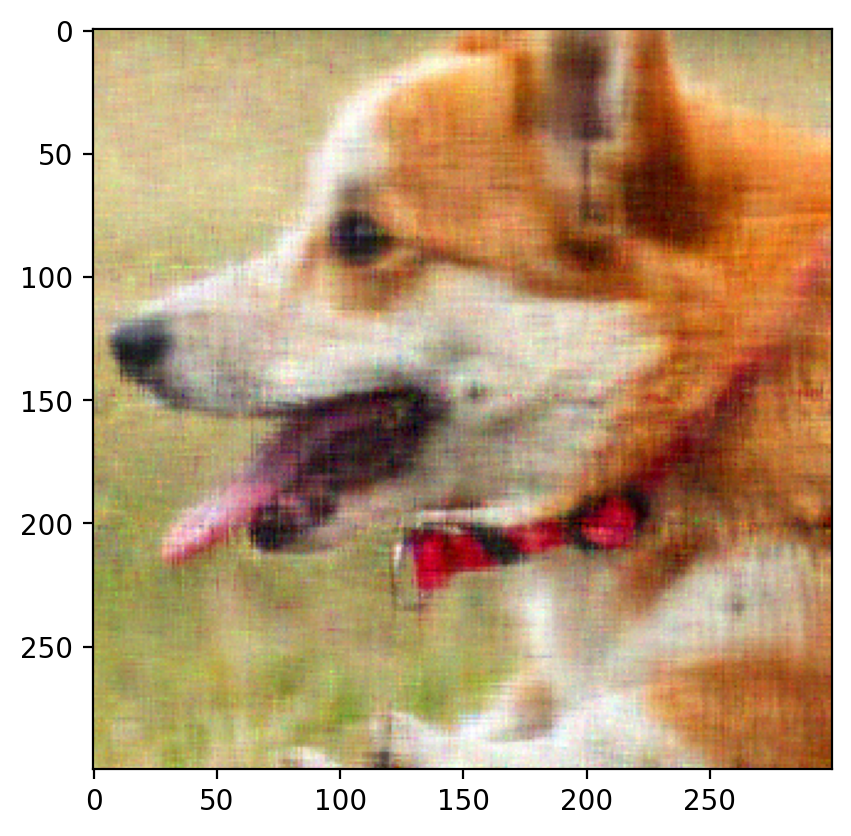

In [12]:
import torch.optim as optim


def factorize(A_list, k, device=torch.device("cpu")):
    # Factorize a list of matrices A_list into lists of matrices W_list and H_list
    W_list = []
    H_list = []
    loss_list = []

    for A in A_list:
        A = A.to(device)

        W = torch.randn(A.shape[0], k, requires_grad=True, device=device)
        H = torch.randn(k, A.shape[1], requires_grad=True, device=device)

        optimizer = optim.Adam([W, H], lr=0.01)
        mask = ~torch.isnan(A)

        for _ in range(1000):

            diff_matrix = torch.mm(W, H) - A  # Compute the loss
            diff_vector = diff_matrix[mask]
            loss = torch.norm(diff_vector)

            optimizer.zero_grad()  # Zero the gradients

            loss.backward()  # Backpropagate

            optimizer.step()  # Update the parameters

        W_list.append(W.detach().clone())
        H_list.append(H.detach().clone())
        loss_list.append(loss.detach().clone())

    return torch.stack(W_list), torch.stack(H_list), torch.stack(loss_list)


W, H, loss = factorize(masked_img[0], 50, device=device)

image_np = torch.matmul(W, H).cpu().numpy()

image_np = np.transpose(image_np, (1, 2, 0))

plt.imshow(image_np)
plt.show()

# Reconstructing using Random Fourier Features

### Select the known coordinates

In [13]:
def create_coordinate_map_mask(img, mask):
    """
    img: torch.Tensor of shape (num_channels, height, width)
    mask: torch.Tensor of shape (height, width)

    return: tuple of torch.Tensor of shape (num_selected_coordinates, 2)
            and torch.Tensor of shape (num_selected_coordinates, num_channels)
    """

    num_channels, height, width = img.shape

    # Create a 2D grid of (x,y) coordinates (h, w)
    # width values change faster than height values
    w_coords = torch.arange(width).repeat(height, 1)
    h_coords = torch.arange(height).repeat(width, 1).t()
    w_coords = w_coords.reshape(-1)
    h_coords = h_coords.reshape(-1)

    # Combine the x and y coordinates into a single tensor
    X = torch.stack([h_coords, w_coords], dim=1).float()

    # Mask the coordinates based on the provided mask
    mask_flat = rearrange(mask, "h w -> (h w)")
    mask_flat = mask_flat.to(X.device)
    mask_flat_not = [not mask_flat[i] for i in range(len(mask_flat))]

    selected_coords = X[mask_flat_not]

    # Move X to GPU if available
    selected_coords = selected_coords.to(device)

    # Reshape the image to (num_selected_coordinates, num_channels)
    Y = rearrange(img, "c h w -> (h w) c")[mask_flat_not].float()

    return selected_coords, Y


selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

### Create Random Fourier Features

In [14]:
def create_rff_features(X, num_features, sigma):
    from sklearn.kernel_approximation import RBFSampler

    rff = RBFSampler(n_components=num_features, gamma=1 / (2 * sigma**2))
    X = X.cpu().numpy()
    X = rff.fit_transform(X)
    return torch.tensor(X, dtype=torch.float32).to(device), rff

### Define a linear model

In [15]:
class LinearModel(nn.Module):
    def __init__(self, in_features, out_features):
        super(LinearModel, self).__init__()
        self.linear = nn.Linear(in_features, out_features)

    def forward(self, x):
        return self.linear(x)


net = LinearModel(2, 3)
net.to(device)

LinearModel(
  (linear): Linear(in_features=2, out_features=3, bias=True)
)

### Scale the coordinates to bring them between -1 and 1

In [16]:
scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

### Create 10000 Random Fourier Features for the image

In [17]:
X_rff, rff = create_rff_features(scaled_coords, 10000, 0.03)

print(X_rff.shape)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

torch.Size([45004, 10000])


LinearModel(
  (linear): Linear(in_features=10000, out_features=3, bias=True)
)

### Train the model on the image to be reconstructed

In [18]:
def train(net, lr, X, Y, epochs, verbose=True):
    """
    net: torch.nn.Module
    lr: float
    X: torch.Tensor of shape (num_samples, 2)
    Y: torch.Tensor of shape (num_samples, 3)
    """

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(net.parameters(), lr=lr)
    for epoch in range(epochs):
        optimizer.zero_grad()
        outputs = net(X)

        loss = criterion(outputs, Y)
        loss.backward()
        optimizer.step()
        if verbose and epoch % 100 == 0:
            print(f"Epoch {epoch} loss: {loss.item():.6f}")
    return loss.item()

In [19]:
train(net, 0.01, X_rff, Y, 250)

Epoch 0 loss: 0.371276
Epoch 100 loss: 0.001815
Epoch 200 loss: 0.001588


0.0015620195772498846

### Clear unnecessary memory

In [20]:
del selected_coords
del masked_img

### Create a coordinate map for the predicted image

In [21]:
def create_coordinate_map(img, scale=1):
    """
    img: torch.Tensor of shape (num_channels, height, width)

    return: tuple of torch.Tensor of shape (height * width, 2) and torch.Tensor of shape (height * width, num_channels)
    """

    num_channels, height, width = img.shape

    # Create a 2D grid of (x,y) coordinates (h, w)
    # width values change faster than height values
    w_coords = torch.arange(0, width, 1 / scale).repeat(int(height * scale), 1)
    h_coords = torch.arange(0, height, 1 / scale).repeat(int(width * scale), 1).t()
    w_coords = w_coords.reshape(-1)
    h_coords = h_coords.reshape(-1)

    # Combine the x and y coordinates into a single tensor
    X = torch.stack([h_coords, w_coords], dim=1).float()

    # Move X to GPU if available
    X = X.to(device)

    # Reshape the image to (h * w, num_channels)
    Y = rearrange(img, "c h w -> (h w) c").float()
    return X, Y


X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

### Plot the predicted and original image

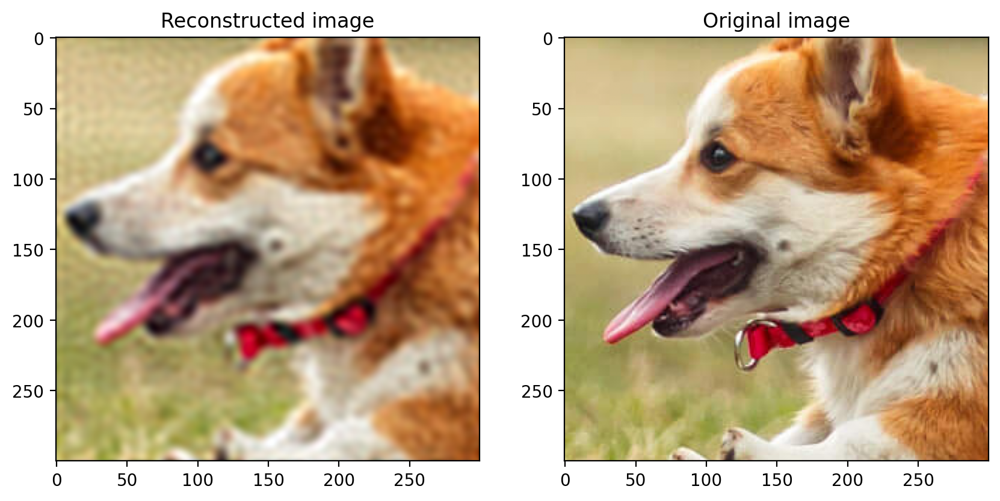

Root Mean Sqaured Error:  tensor(0.0408, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 27.79481372957957


In [22]:
# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

In [ ]:
del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred

# Full code

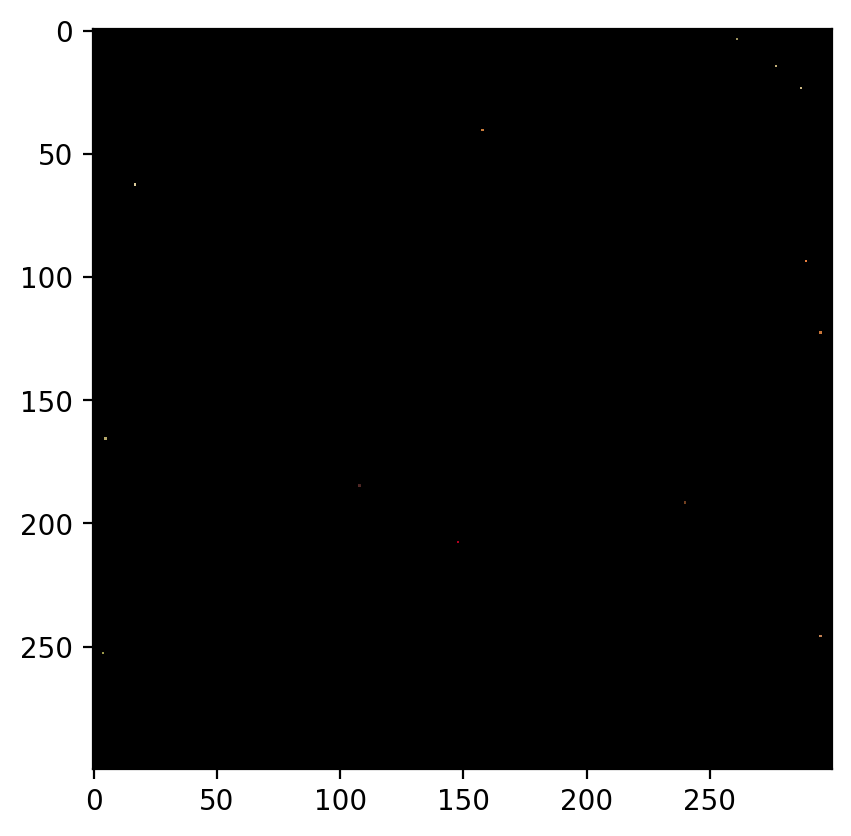

Epoch 0 loss: 0.367426
Epoch 100 loss: 0.002535
Epoch 200 loss: 0.001086
Epoch 300 loss: 0.000946
Epoch 400 loss: 0.000908
Epoch 500 loss: 0.000891
Epoch 600 loss: 0.000881
Epoch 700 loss: 0.000874
Epoch 800 loss: 0.000869
Epoch 900 loss: 0.000865
Epoch 1000 loss: 0.000861
Epoch 1100 loss: 0.000858
Epoch 1200 loss: 0.000856
Epoch 1300 loss: 0.000853
Epoch 1400 loss: 0.000851
Epoch 1500 loss: 0.000849
Epoch 1600 loss: 0.000847
Epoch 1700 loss: 0.000846
Epoch 1800 loss: 0.000844
Epoch 1900 loss: 0.000843
Epoch 2000 loss: 0.000842
Epoch 2100 loss: 0.000840
Epoch 2200 loss: 0.000839
Epoch 2300 loss: 0.000838
Epoch 2400 loss: 0.000837


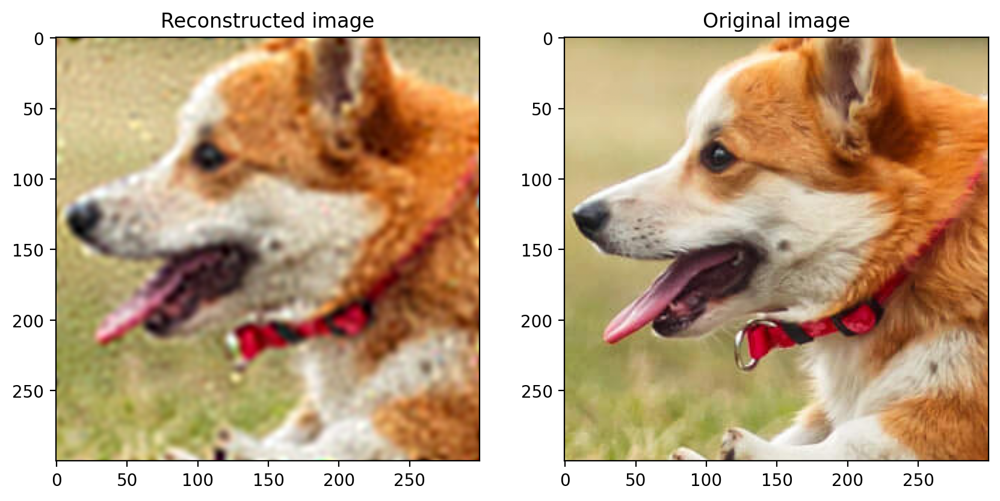

Root Mean Sqaured Error:  tensor(0.0489, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 26.21295387255499


In [25]:
masked_img = mask_image_rgb(crop, 0.9)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.025)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### Observation - Changing sigma

Sigma increases - bias increases

Sigma decreases - variance increases

### Removing different amounts of data from the image and observing reconstruction results:

In [26]:
rmse_arr = []
psnr_arr = []

### 90% Data Removed

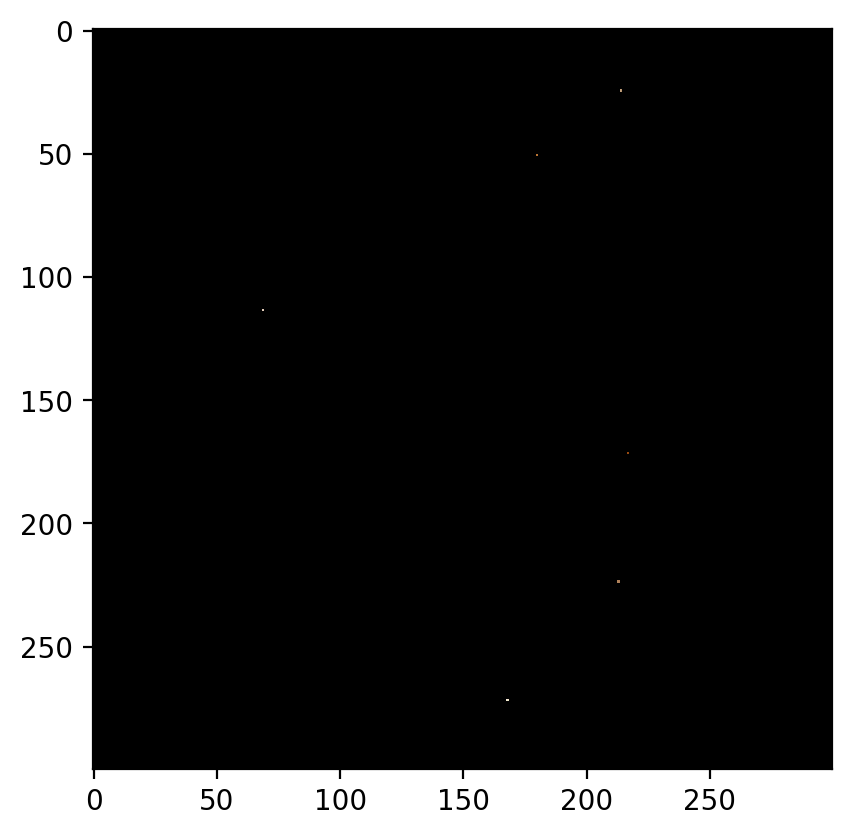

Epoch 0 loss: 0.380242
Epoch 100 loss: 0.006023
Epoch 200 loss: 0.001729
Epoch 300 loss: 0.000875
Epoch 400 loss: 0.000567
Epoch 500 loss: 0.000421
Epoch 600 loss: 0.000341
Epoch 700 loss: 0.000294
Epoch 800 loss: 0.000263
Epoch 900 loss: 0.000243
Epoch 1000 loss: 0.000230
Epoch 1100 loss: 0.000220
Epoch 1200 loss: 0.000213
Epoch 1300 loss: 0.000207
Epoch 1400 loss: 0.000203
Epoch 1500 loss: 0.000199
Epoch 1600 loss: 0.000197
Epoch 1700 loss: 0.000194
Epoch 1800 loss: 0.000192
Epoch 1900 loss: 0.000191
Epoch 2000 loss: 0.000189
Epoch 2100 loss: 0.000188
Epoch 2200 loss: 0.000187
Epoch 2300 loss: 0.000186
Epoch 2400 loss: 0.000185


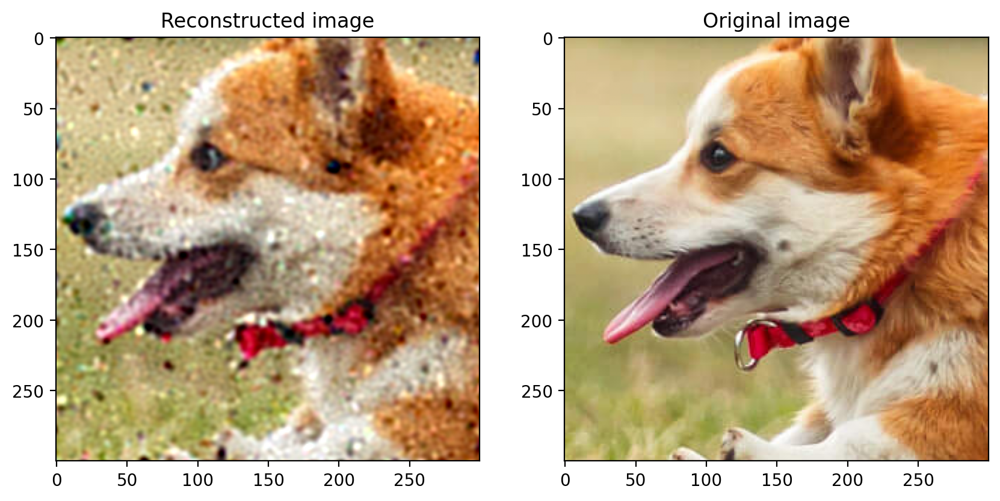

Root Mean Sqaured Error:  tensor(0.0786, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 22.08719840300042


In [27]:
masked_img = mask_image_rgb(crop, 0.9)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 80% Data Removed

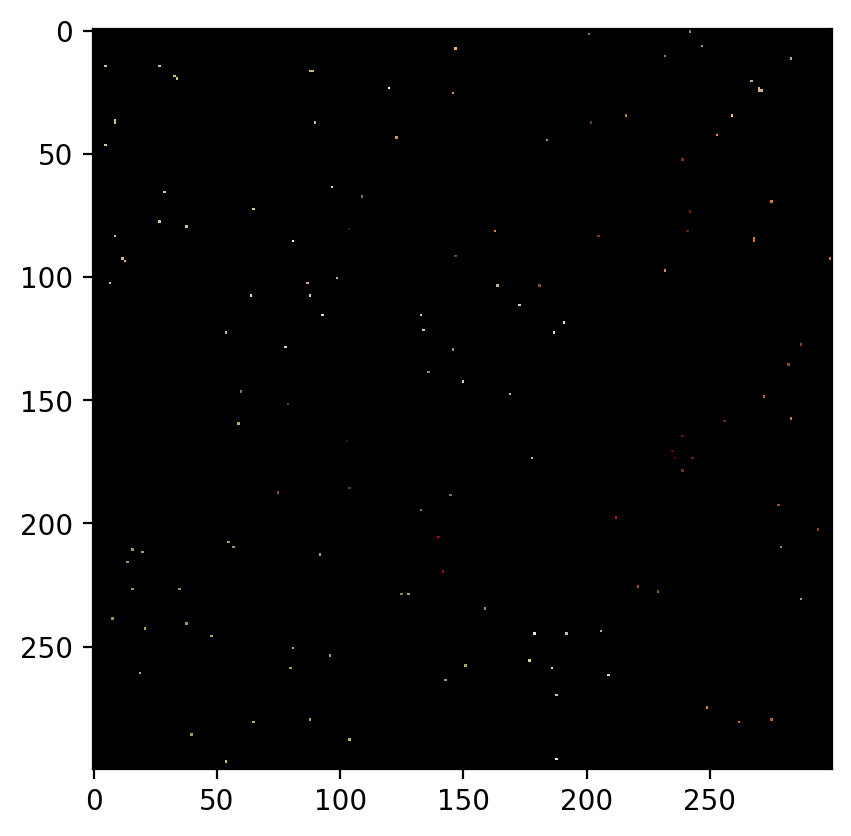

Epoch 0 loss: 0.367108
Epoch 100 loss: 0.005242
Epoch 200 loss: 0.001157
Epoch 300 loss: 0.000682
Epoch 400 loss: 0.000586
Epoch 500 loss: 0.000557
Epoch 600 loss: 0.000544
Epoch 700 loss: 0.000536
Epoch 800 loss: 0.000530
Epoch 900 loss: 0.000526
Epoch 1000 loss: 0.000524
Epoch 1100 loss: 0.000521
Epoch 1200 loss: 0.000520
Epoch 1300 loss: 0.000518
Epoch 1400 loss: 0.000517
Epoch 1500 loss: 0.000516
Epoch 1600 loss: 0.000514
Epoch 1700 loss: 0.000514
Epoch 1800 loss: 0.000513
Epoch 1900 loss: 0.000512
Epoch 2000 loss: 0.000511
Epoch 2100 loss: 0.000511
Epoch 2200 loss: 0.000510
Epoch 2300 loss: 0.000509
Epoch 2400 loss: 0.000509


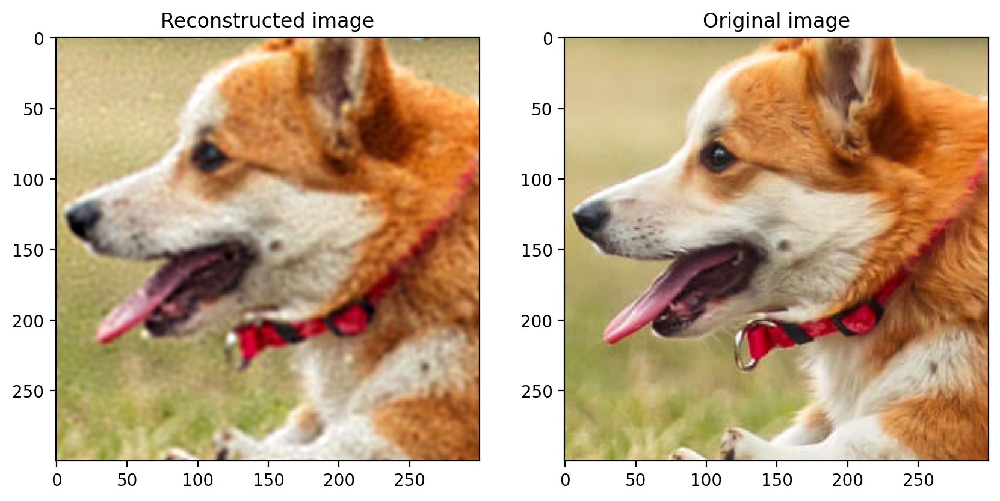

Root Mean Sqaured Error:  tensor(0.0387, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 28.25418146450278


In [28]:
masked_img = mask_image_rgb(crop, 0.8)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 70% Data Removed

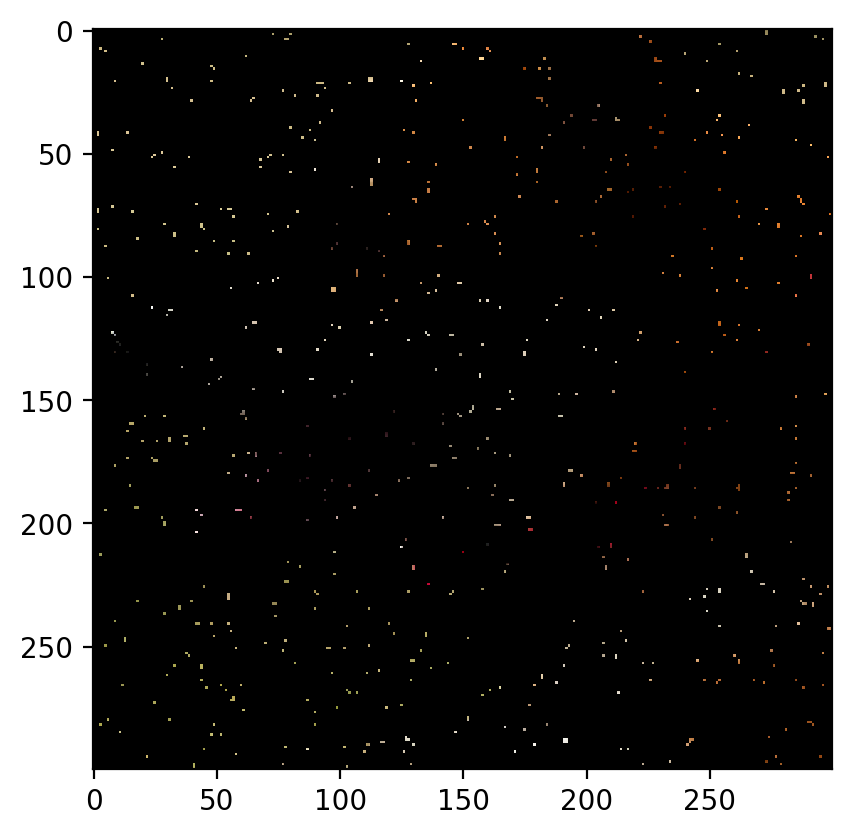

Epoch 0 loss: 0.367567
Epoch 100 loss: 0.005955
Epoch 200 loss: 0.001499
Epoch 300 loss: 0.000888
Epoch 400 loss: 0.000764
Epoch 500 loss: 0.000731
Epoch 600 loss: 0.000717
Epoch 700 loss: 0.000710
Epoch 800 loss: 0.000705
Epoch 900 loss: 0.000701
Epoch 1000 loss: 0.000698
Epoch 1100 loss: 0.000695
Epoch 1200 loss: 0.000693
Epoch 1300 loss: 0.000691
Epoch 1400 loss: 0.000690
Epoch 1500 loss: 0.000688
Epoch 1600 loss: 0.000687
Epoch 1700 loss: 0.000686
Epoch 1800 loss: 0.000685
Epoch 1900 loss: 0.000683
Epoch 2000 loss: 0.000682
Epoch 2100 loss: 0.000682
Epoch 2200 loss: 0.000681
Epoch 2300 loss: 0.000680
Epoch 2400 loss: 0.000679


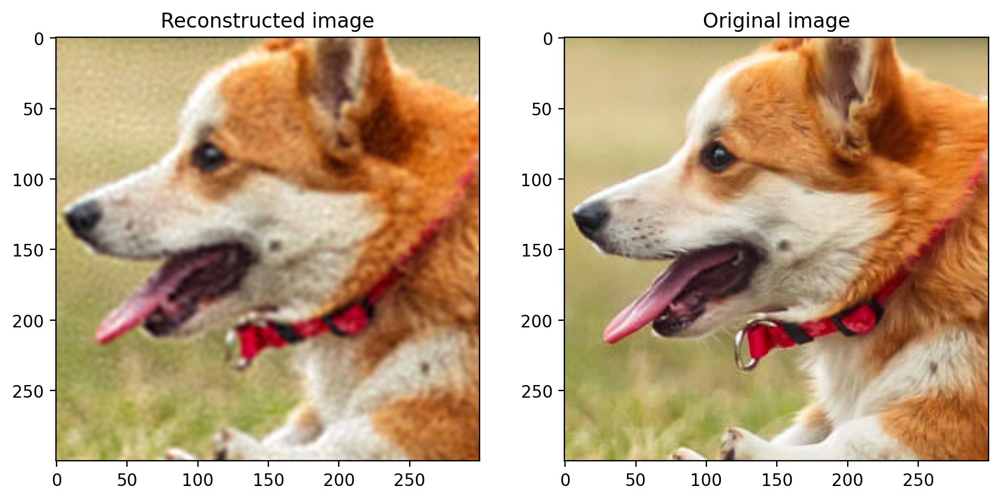

Root Mean Sqaured Error:  tensor(0.0330, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 29.63423604352773


In [29]:
masked_img = mask_image_rgb(crop, 0.7)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 60% Data Removed

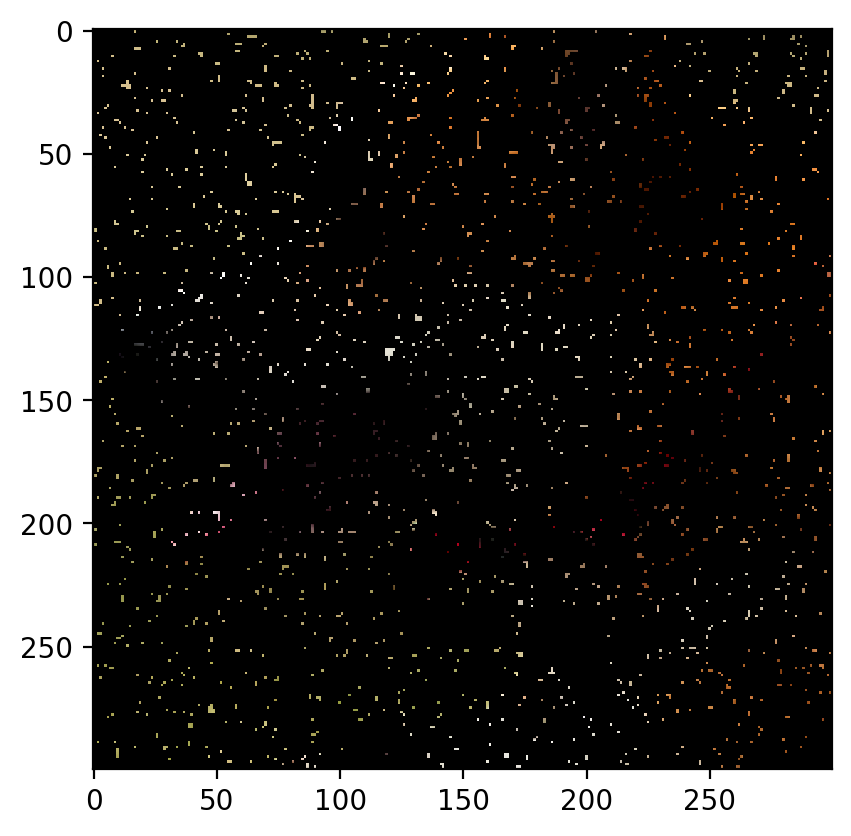

Epoch 0 loss: 0.370094
Epoch 100 loss: 0.007418
Epoch 200 loss: 0.002277
Epoch 300 loss: 0.001190
Epoch 400 loss: 0.000875
Epoch 500 loss: 0.000783
Epoch 600 loss: 0.000752
Epoch 700 loss: 0.000738
Epoch 800 loss: 0.000731
Epoch 900 loss: 0.000725
Epoch 1000 loss: 0.000722
Epoch 1100 loss: 0.000719
Epoch 1200 loss: 0.000716
Epoch 1300 loss: 0.000715
Epoch 1400 loss: 0.000713
Epoch 1500 loss: 0.000712
Epoch 1600 loss: 0.000711
Epoch 1700 loss: 0.000709
Epoch 1800 loss: 0.000709
Epoch 1900 loss: 0.000708
Epoch 2000 loss: 0.000707
Epoch 2100 loss: 0.000706
Epoch 2200 loss: 0.000705
Epoch 2300 loss: 0.000705
Epoch 2400 loss: 0.000704


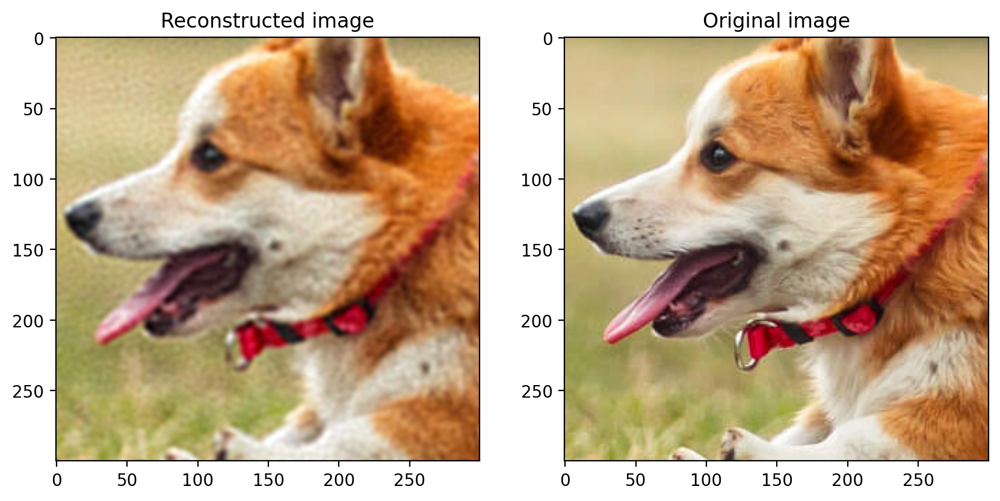

Root Mean Sqaured Error:  tensor(0.0309, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 30.210612612395682


In [30]:
masked_img = mask_image_rgb(crop, 0.6)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 50% Data Removed

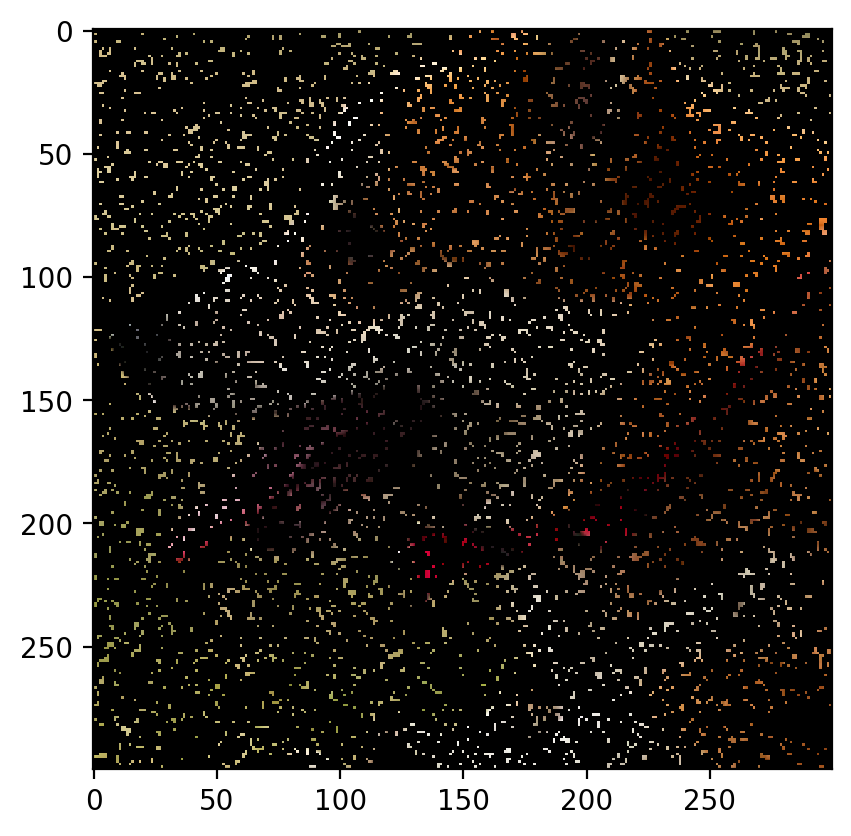

Epoch 0 loss: 0.369567
Epoch 100 loss: 0.005086
Epoch 200 loss: 0.001252
Epoch 300 loss: 0.000865
Epoch 400 loss: 0.000806
Epoch 500 loss: 0.000789
Epoch 600 loss: 0.000780
Epoch 700 loss: 0.000774
Epoch 800 loss: 0.000769
Epoch 900 loss: 0.000766
Epoch 1000 loss: 0.000763
Epoch 1100 loss: 0.000761
Epoch 1200 loss: 0.000759
Epoch 1300 loss: 0.000758
Epoch 1400 loss: 0.000756
Epoch 1500 loss: 0.000755
Epoch 1600 loss: 0.000754
Epoch 1700 loss: 0.000753
Epoch 1800 loss: 0.000752
Epoch 1900 loss: 0.000751
Epoch 2000 loss: 0.000751
Epoch 2100 loss: 0.000750
Epoch 2200 loss: 0.000749
Epoch 2300 loss: 0.000749
Epoch 2400 loss: 0.000748


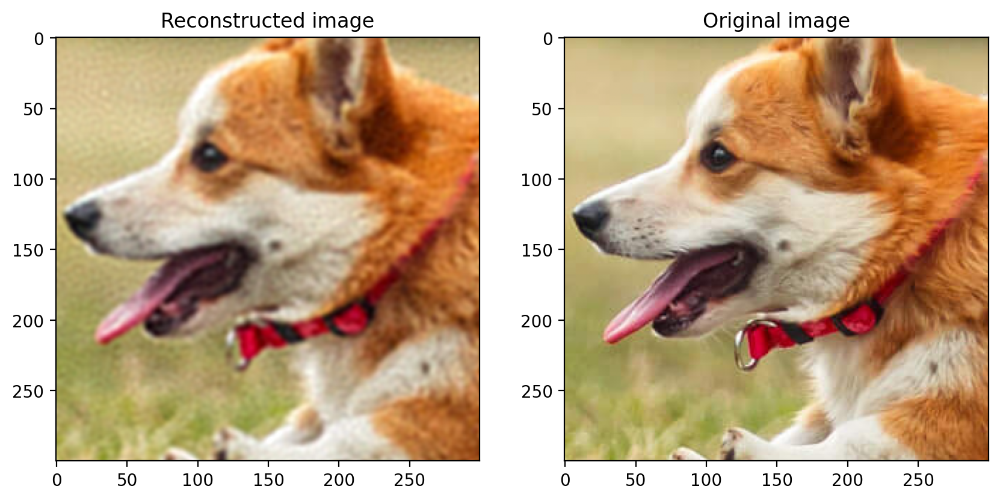

Root Mean Sqaured Error:  tensor(0.0301, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 30.43539642977963


In [31]:
masked_img = mask_image_rgb(crop, 0.5)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 40% Data Removed

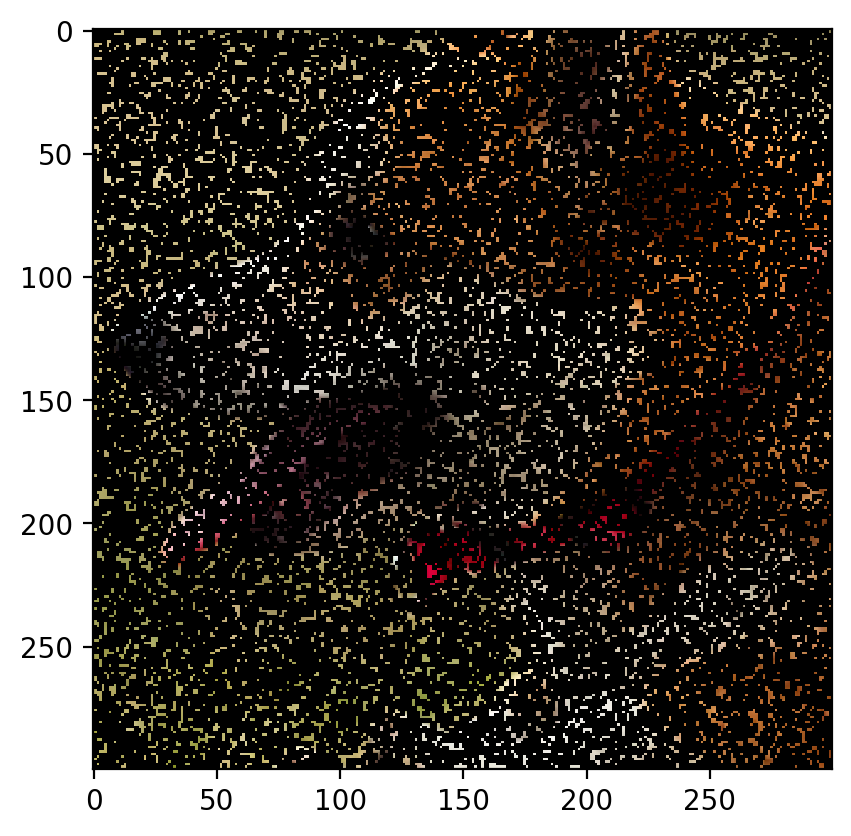

Epoch 0 loss: 0.377197
Epoch 100 loss: 0.003750
Epoch 200 loss: 0.001084
Epoch 300 loss: 0.000868
Epoch 400 loss: 0.000835
Epoch 500 loss: 0.000823
Epoch 600 loss: 0.000816
Epoch 700 loss: 0.000811
Epoch 800 loss: 0.000807
Epoch 900 loss: 0.000805
Epoch 1000 loss: 0.000803
Epoch 1100 loss: 0.000801
Epoch 1200 loss: 0.000799
Epoch 1300 loss: 0.000798
Epoch 1400 loss: 0.000797
Epoch 1500 loss: 0.000796
Epoch 1600 loss: 0.000795
Epoch 1700 loss: 0.000794
Epoch 1800 loss: 0.000793
Epoch 1900 loss: 0.000792
Epoch 2000 loss: 0.000792
Epoch 2100 loss: 0.000791
Epoch 2200 loss: 0.000790
Epoch 2300 loss: 0.000790
Epoch 2400 loss: 0.000789


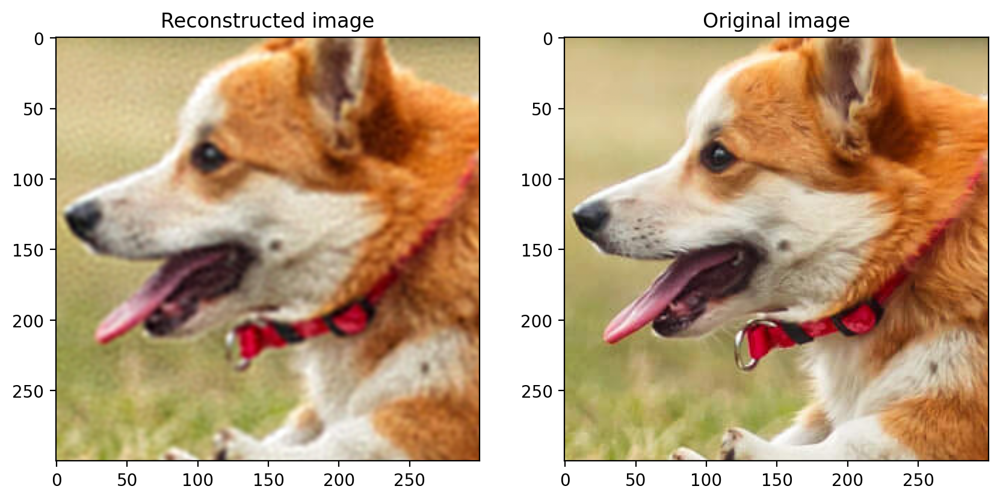

Root Mean Sqaured Error:  tensor(0.0295, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 30.596299417410222


In [32]:
masked_img = mask_image_rgb(crop, 0.4)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 30% Data Removed

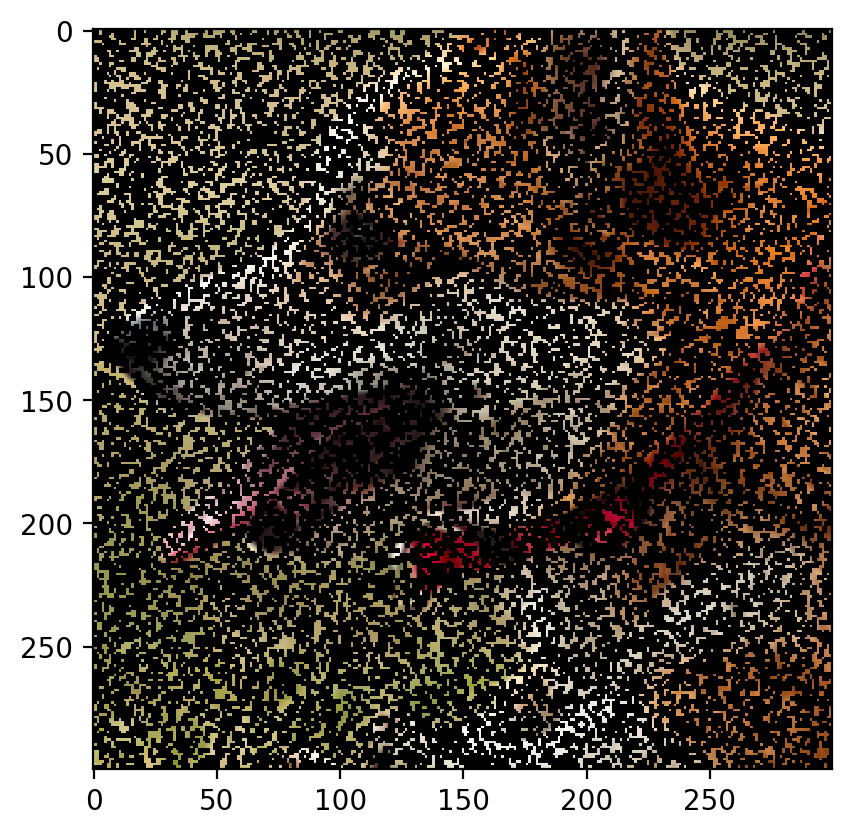

Epoch 0 loss: 0.370570
Epoch 100 loss: 0.004116
Epoch 200 loss: 0.001218
Epoch 300 loss: 0.000895
Epoch 400 loss: 0.000843
Epoch 500 loss: 0.000829
Epoch 600 loss: 0.000822
Epoch 700 loss: 0.000817
Epoch 800 loss: 0.000813
Epoch 900 loss: 0.000810
Epoch 1000 loss: 0.000808
Epoch 1100 loss: 0.000806
Epoch 1200 loss: 0.000805
Epoch 1300 loss: 0.000803
Epoch 1400 loss: 0.000802
Epoch 1500 loss: 0.000801
Epoch 1600 loss: 0.000800
Epoch 1700 loss: 0.000799
Epoch 1800 loss: 0.000798
Epoch 1900 loss: 0.000798
Epoch 2000 loss: 0.000797
Epoch 2100 loss: 0.000796
Epoch 2200 loss: 0.000796
Epoch 2300 loss: 0.000795
Epoch 2400 loss: 0.000795


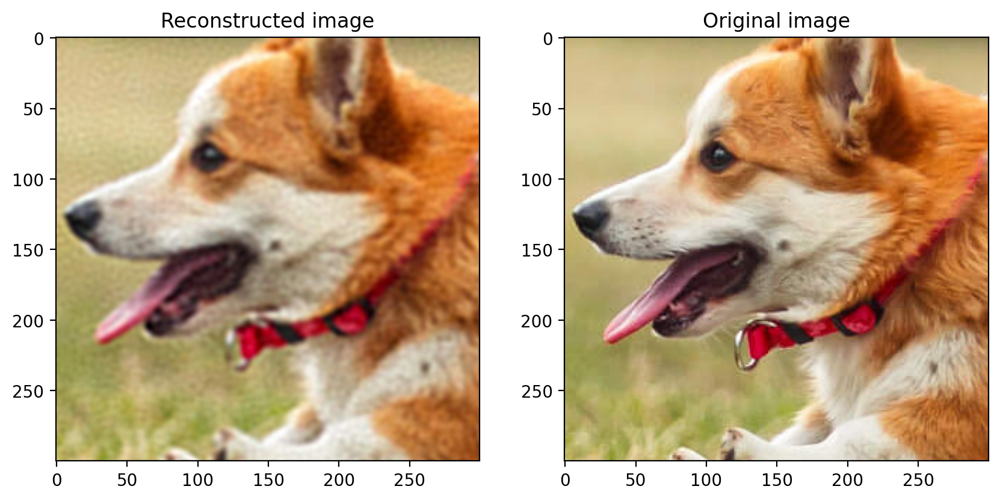

Root Mean Sqaured Error:  tensor(0.0292, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 30.686033211585062


In [33]:
masked_img = mask_image_rgb(crop, 0.3)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 20% Data Removed

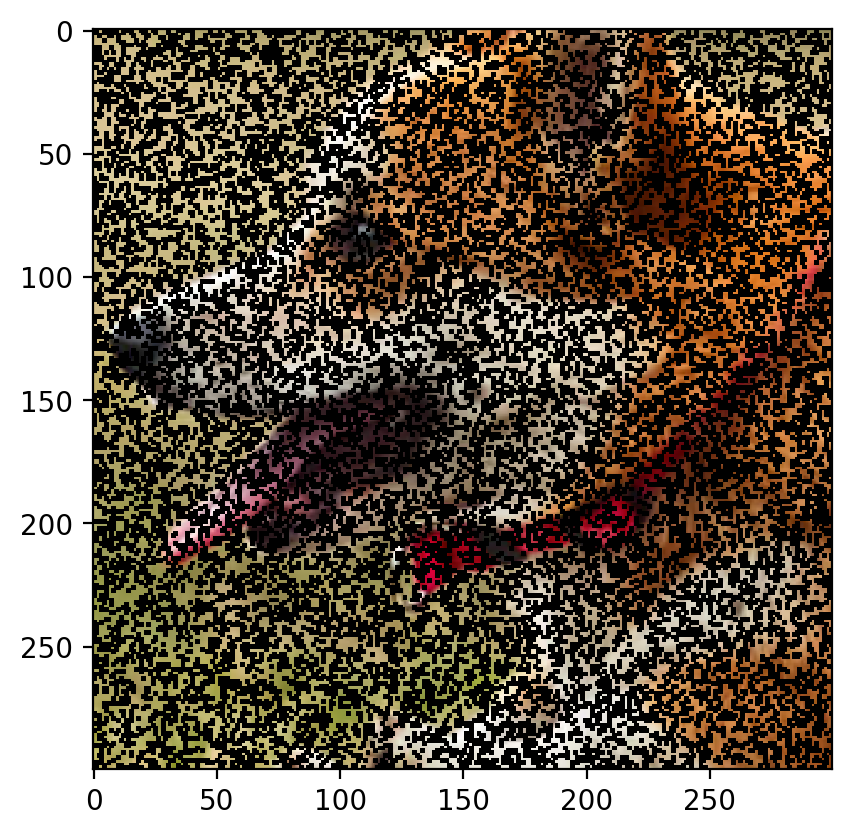

Epoch 0 loss: 0.370274
Epoch 100 loss: 0.004084
Epoch 200 loss: 0.001145
Epoch 300 loss: 0.000876
Epoch 400 loss: 0.000838
Epoch 500 loss: 0.000825
Epoch 600 loss: 0.000818
Epoch 700 loss: 0.000814
Epoch 800 loss: 0.000810
Epoch 900 loss: 0.000808
Epoch 1000 loss: 0.000806
Epoch 1100 loss: 0.000804
Epoch 1200 loss: 0.000803
Epoch 1300 loss: 0.000801
Epoch 1400 loss: 0.000800
Epoch 1500 loss: 0.000799
Epoch 1600 loss: 0.000798
Epoch 1700 loss: 0.000797
Epoch 1800 loss: 0.000796
Epoch 1900 loss: 0.000796
Epoch 2000 loss: 0.000795
Epoch 2100 loss: 0.000794
Epoch 2200 loss: 0.000793
Epoch 2300 loss: 0.000793
Epoch 2400 loss: 0.000792


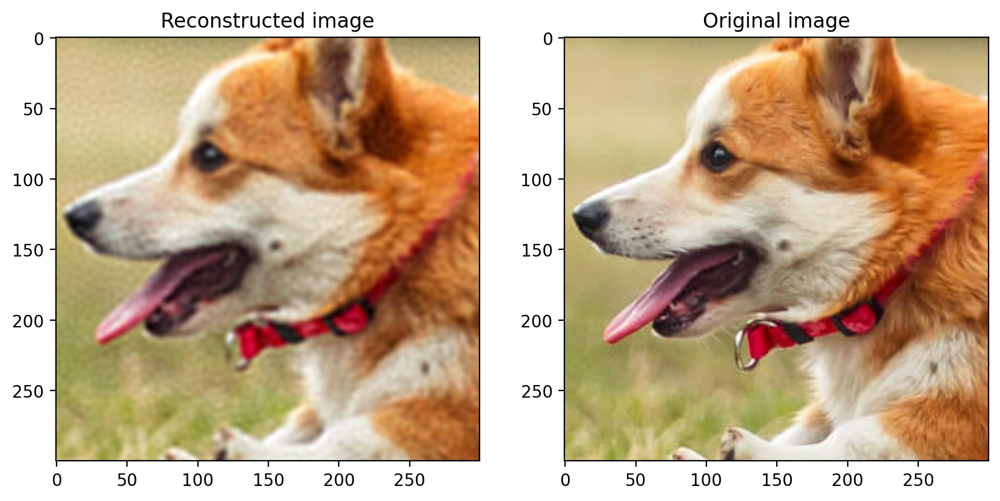

Root Mean Sqaured Error:  tensor(0.0289, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 30.78619621879038


In [34]:
masked_img = mask_image_rgb(crop, 0.2)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

### 10% Data Removed

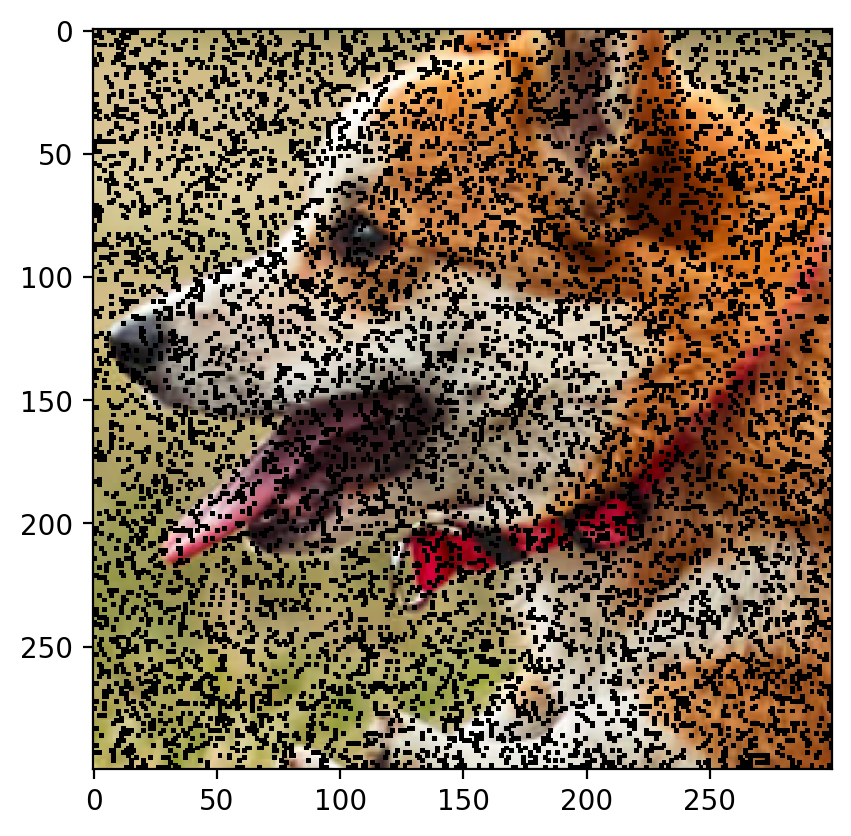

Epoch 0 loss: 0.372689
Epoch 100 loss: 0.004569
Epoch 200 loss: 0.001149
Epoch 300 loss: 0.000897
Epoch 400 loss: 0.000864
Epoch 500 loss: 0.000850
Epoch 600 loss: 0.000841
Epoch 700 loss: 0.000835
Epoch 800 loss: 0.000830
Epoch 900 loss: 0.000827
Epoch 1000 loss: 0.000824
Epoch 1100 loss: 0.000822
Epoch 1200 loss: 0.000820
Epoch 1300 loss: 0.000819
Epoch 1400 loss: 0.000818
Epoch 1500 loss: 0.000817
Epoch 1600 loss: 0.000816
Epoch 1700 loss: 0.000815
Epoch 1800 loss: 0.000814
Epoch 1900 loss: 0.000813
Epoch 2000 loss: 0.000813
Epoch 2100 loss: 0.000812
Epoch 2200 loss: 0.000811
Epoch 2300 loss: 0.000811
Epoch 2400 loss: 0.000810


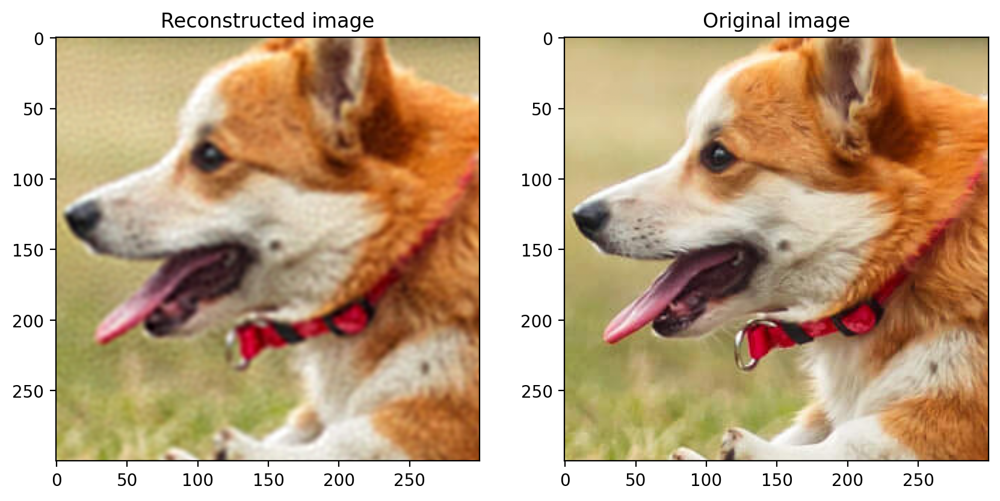

Root Mean Sqaured Error:  tensor(0.0286, device='cuda:0', dtype=torch.float64, grad_fn=<MeanBackward0>)
PSNR: 30.86548449905607


In [35]:
masked_img = mask_image_rgb(crop, 0.1)

image_np = masked_img[0].cpu().numpy()

# Rearrange the dimensions if necessary (assuming it's a color image)
image_np = np.transpose(image_np, (1, 2, 0))

# Display the image using Matplotlib
plt.imshow(image_np)
plt.show()

selected_coords, Y = create_coordinate_map_mask(crop, masked_img[1])

net = LinearModel(2, 3)
net.to(device)

scaler = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(selected_coords.cpu())
scaled_coords = torch.tensor(scaler.transform(selected_coords.cpu())).float().to(device)

X_rff, rff = create_rff_features(scaled_coords, 10000, 0.015)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.01, X_rff, Y, 2500)

del selected_coords
del masked_img

X, Y = create_coordinate_map(crop)
X_scaled = torch.tensor(scaler.transform(X.cpu())).float().to(device)
X_transformed = torch.tensor(
    rff.transform(X_scaled.cpu().numpy()), dtype=torch.float32
).to(device)
X_pred = net(torch.tensor(X_transformed).to(device)).to(device)

# Assuming X_pred is a PyTorch tensor on the GPU
image_np = rearrange(X_pred, "(h w) c -> c h w", h=300, w=300)

# Assuming crop is a PyTorch tensor on the GPU or a NumPy array
crop_cpu = crop.cpu().detach().numpy() if isinstance(crop, torch.Tensor) else crop
crop_np = rearrange(crop_cpu, "c h w -> h w c")

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].imshow(rearrange(image_np, "c h w -> h w c").detach().cpu().numpy())
axs[0].set_title("Reconstructed image")

axs[1].imshow(crop_np)
axs[1].set_title("Original image")

plt.show()

from sklearn.metrics import mean_squared_error
import math

rmse = torch.sqrt(torch.mean((crop - image_np) ** 2))
print("Root Mean Sqaured Error: ", rmse)

psnr = 20 * np.log10(1.0 / rmse.cpu().detach().numpy())
print("PSNR:", psnr)

del image_np
del X, Y, net, scaler, X_rff, rff, X_scaled, X_transformed, X_pred, crop_cpu, crop_np

In [36]:
rmse_arr

[]

# Plots

## RMSE vs % of data removed

RMSE value for different % of image removed during training


Text(0, 0.5, 'RMSE')

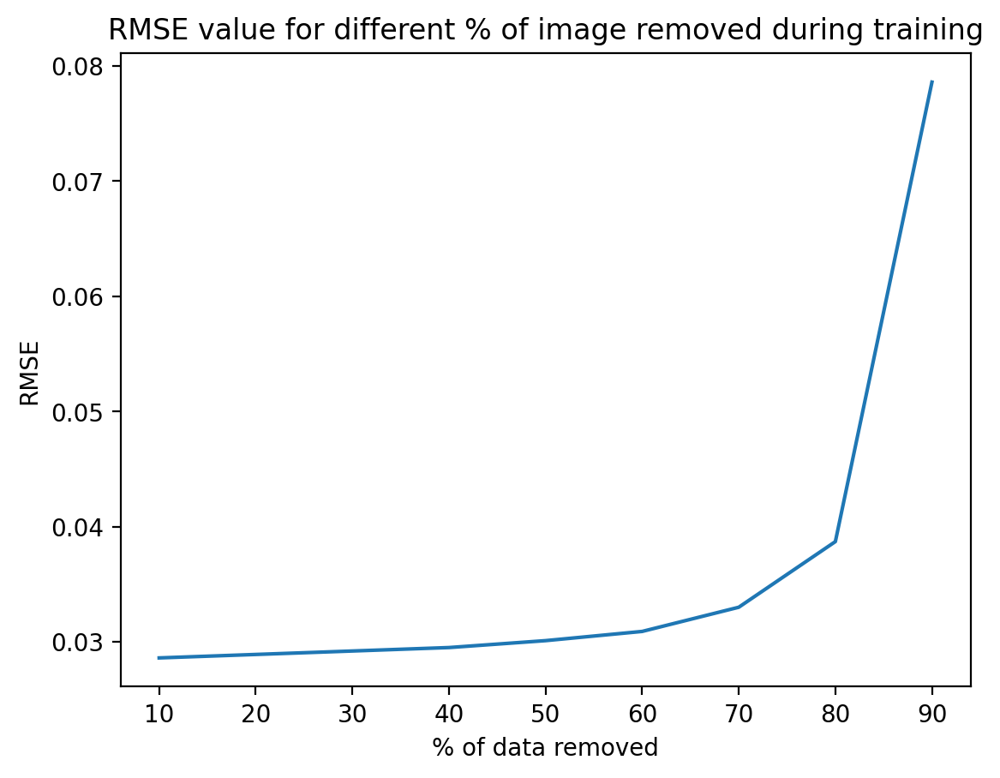

In [40]:
print("RMSE value for different % of image removed during training")
plt.plot(
    np.array([90, 80, 70, 60, 50, 40, 30, 20, 10]),
    [0.0786, 0.0387, 0.0330, 0.0309, 0.0301, 0.0295, 0.0292, 0.0289, 0.0286],
)
plt.title("RMSE value for different % of image removed during training")
plt.xlabel("% of data removed")
plt.ylabel("RMSE")

## Peak SNR vs % of data removed

Peak SNR value for different % of image removed during training


Text(0, 0.5, 'Peak SNR')

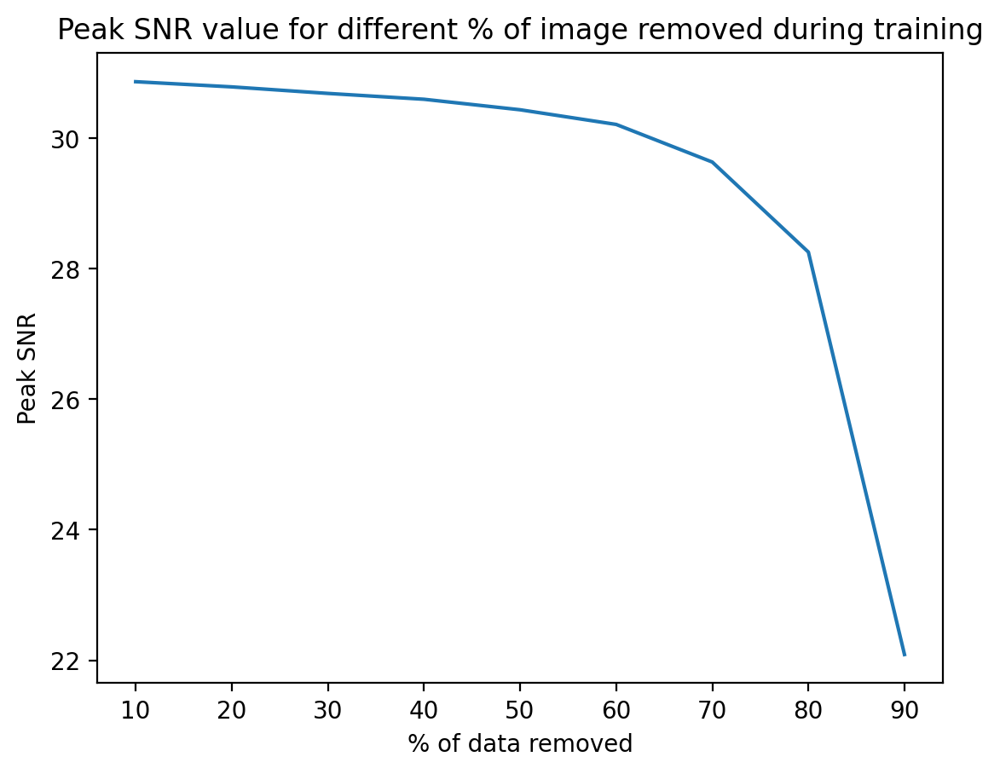

In [43]:
print("Peak SNR value for different % of image removed during training")
plt.title("Peak SNR value for different % of image removed during training")
plt.plot(
    np.array([90, 80, 70, 60, 50, 40, 30, 20, 10]),
    [
        22.08719840300042,
        28.25418146450278,
        29.63423604352773,
        30.210612612395682,
        30.43539642977963,
        30.596299417410222,
        30.686033211585062,
        30.78619621879038,
        30.86548449905607,
    ],
)
plt.xlabel("% of data removed")
plt.ylabel("Peak SNR")